In [16]:
%pip install ipywidgets

Note: you may need to restart the kernel to use updated packages.


In [17]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from IPython.display import display
import PIL.Image
import ipywidgets as widgets

In [18]:
def carregar_imagem_rgb(caminho):
    img = cv2.imread(caminho)
    if img is None:
        raise FileNotFoundError(f"Imagem não encontrada: {caminho}")
    return img


In [19]:
img_lena = carregar_imagem_rgb('images/lena.png')
img_chips = carregar_imagem_rgb('images/chips.png')
img_rgbcube = carregar_imagem_rgb('images/rgbcube_kBKG.png')
img_hsv_disk = carregar_imagem_rgb('images/hsv_disk.png')
img_monkey = carregar_imagem_rgb('images/monkey.jpeg')
img_strawberries = carregar_imagem_rgb('images/strawberries.tif')

In [20]:
imagens = {
    'lena.png': img_lena,
    'chips.png': img_chips,
    'rgbcube_kBKG.png': img_rgbcube,
    'hsv_disk.png': img_hsv_disk,
    'monkey.jpeg': img_monkey,
    'strawberries.tif': img_strawberries,
}



1. Display Color Histograms for RGB Images

Objective: Calculate and display separate histograms for the R, G, and B channels of a color image.

Topics: Color histograms, channel separation.

Challenge: Compare histograms of different images (e.g., nature vs. synthetic images).

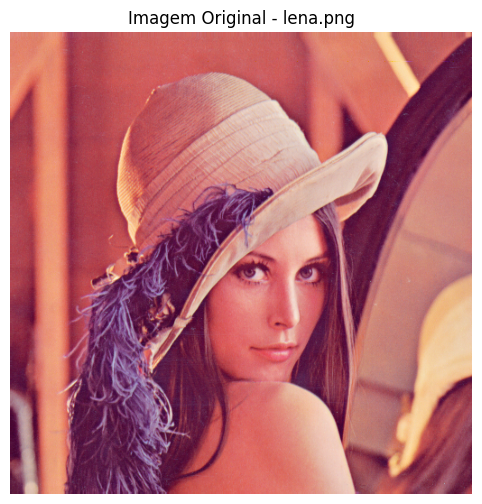

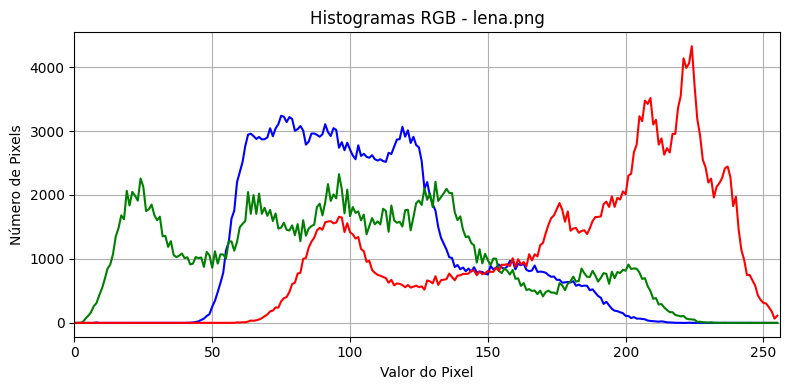

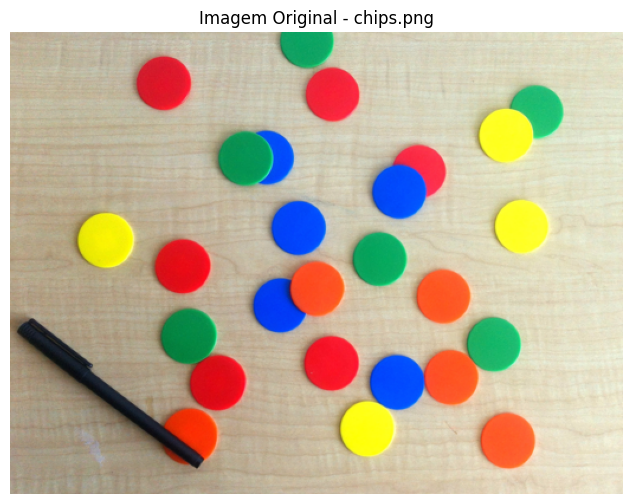

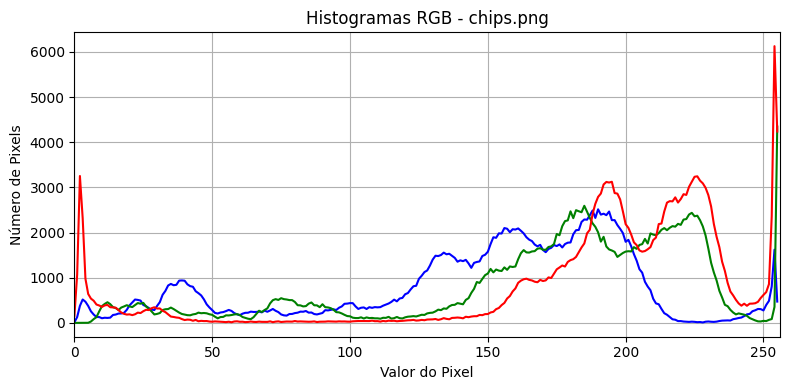

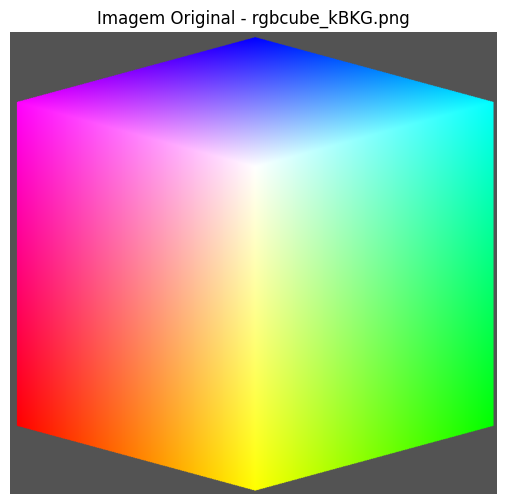

...

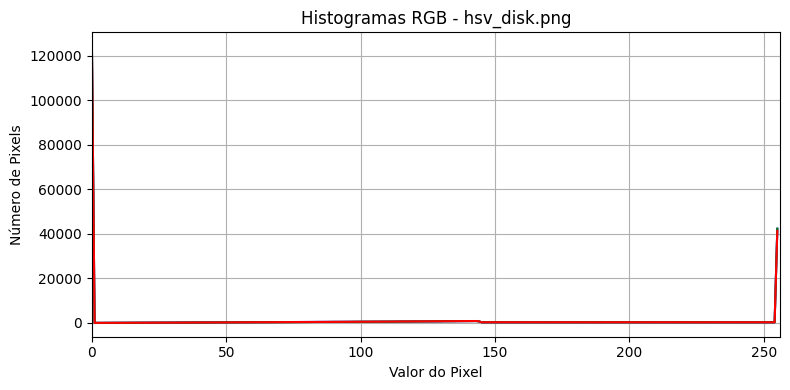

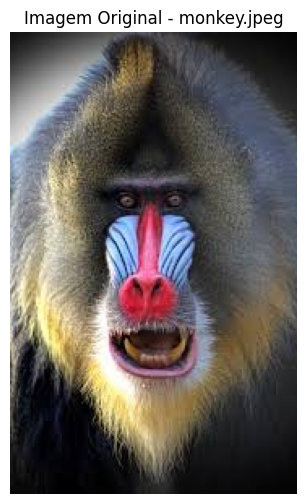

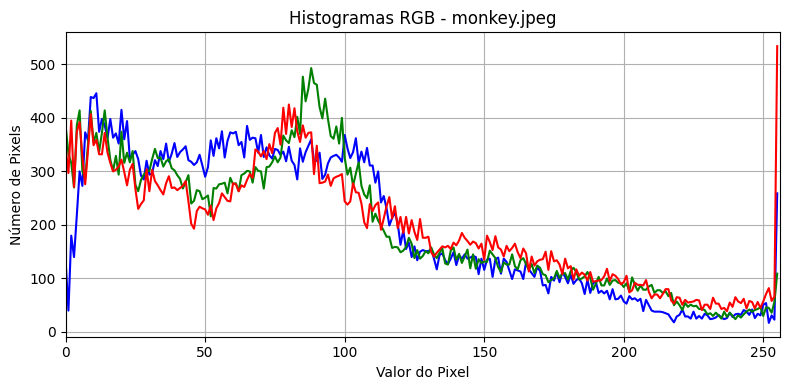

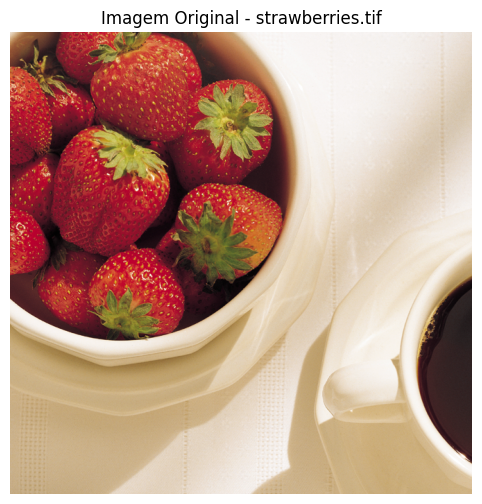

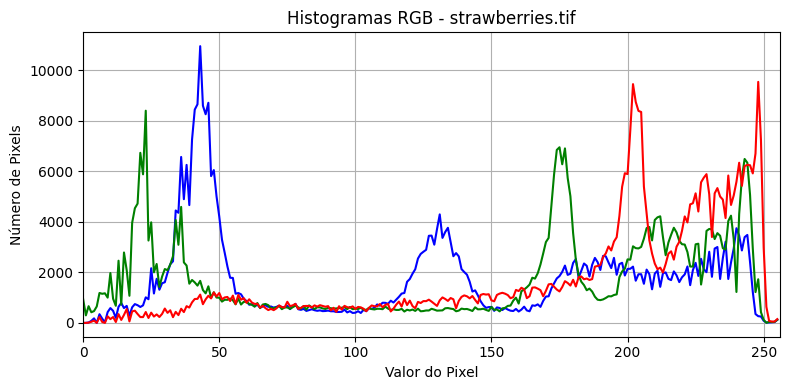

In [21]:


def plot_rgb_histograms(image, title):
    chans = cv2.split(image)
    colors = ('b', 'g', 'r')

    plt.figure(figsize=(8, 4))
    plt.title(f"Histogramas RGB - {title}")
    plt.xlabel("Valor do Pixel")
    plt.ylabel("Número de Pixels")

    for chan, color in zip(chans, colors):
        hist = cv2.calcHist([chan], [0], None, [256], [0, 256])
        plt.plot(hist, color=color)
        plt.xlim([0, 256])

    plt.grid(True)
    plt.tight_layout()
    plt.show()

for nome_arquivo, imagem_bgr in imagens.items():
    imagem_rgb = cv2.cvtColor(imagem_bgr, cv2.COLOR_BGR2RGB)
    plt.figure(figsize=(8, 6))
    plt.imshow(imagem_rgb)
    plt.title(f"Imagem Original - {nome_arquivo}")
    plt.axis('off')
    plt.show()
    plot_rgb_histograms(imagem_bgr, nome_arquivo)


2. Visualize Individual Color Channels

Objective: Extract and display the Red, Green, and Blue channels of a color image as grayscale and pseudo-colored images.

Topics: Channel separation and visualization.

Bonus: Reconstruct the original image using the separated channels.

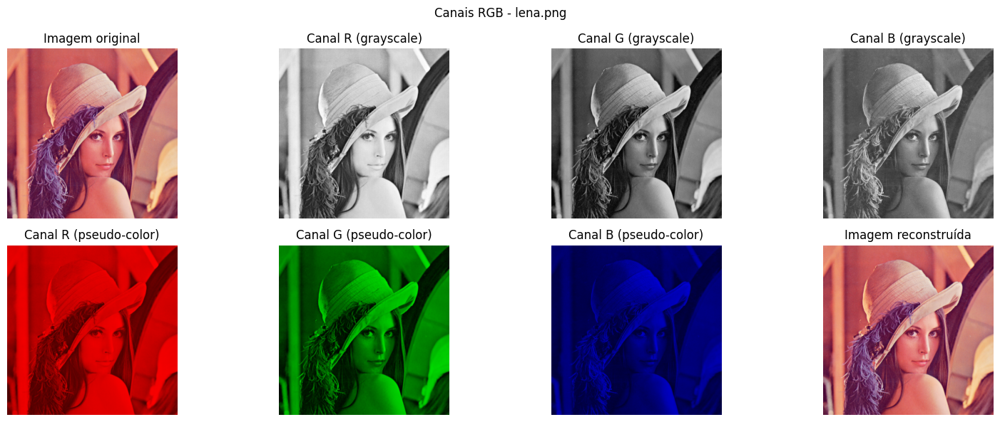

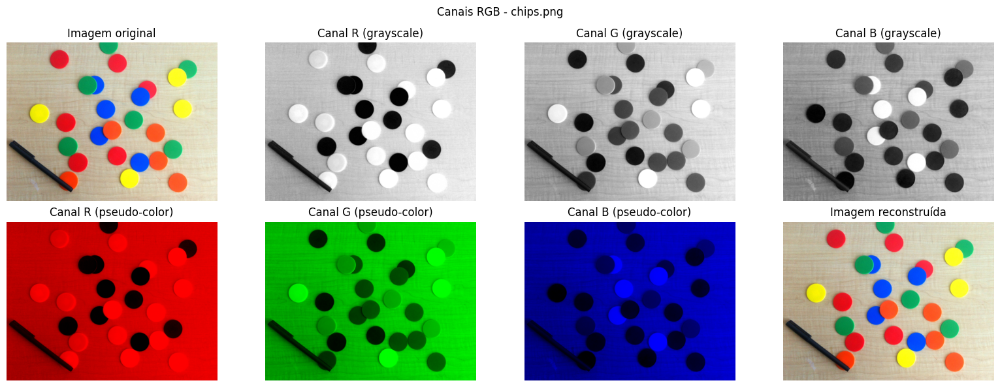

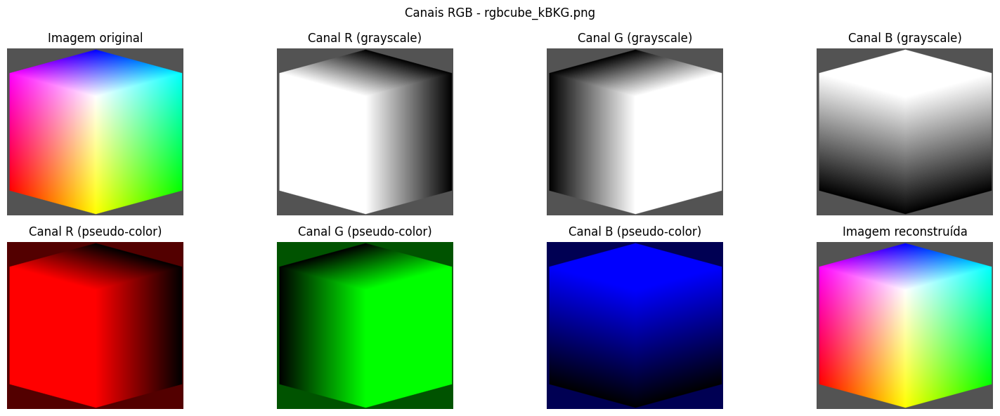

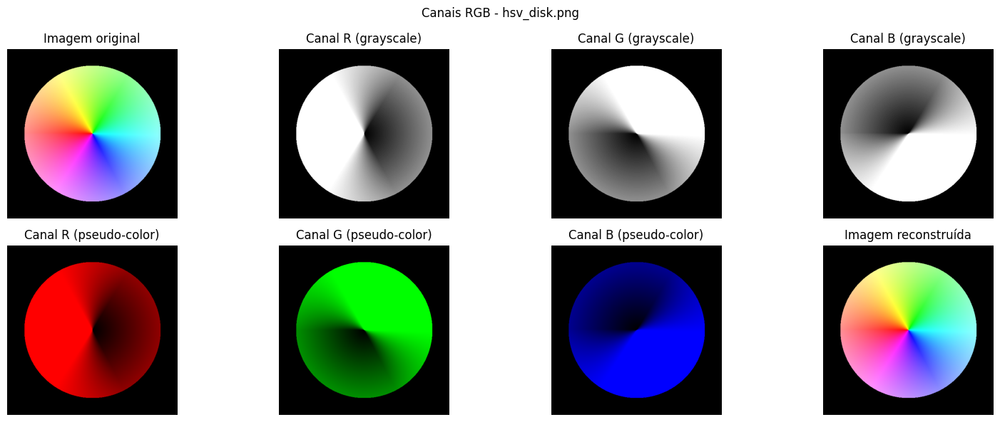

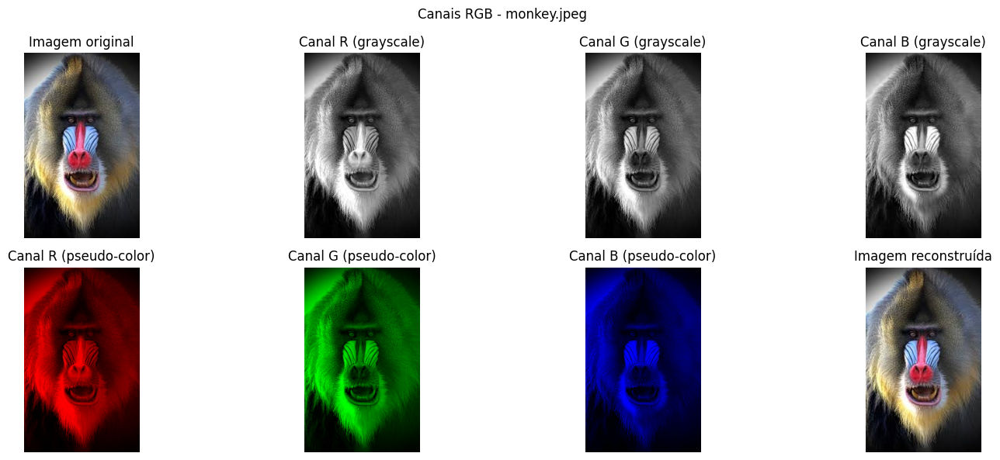

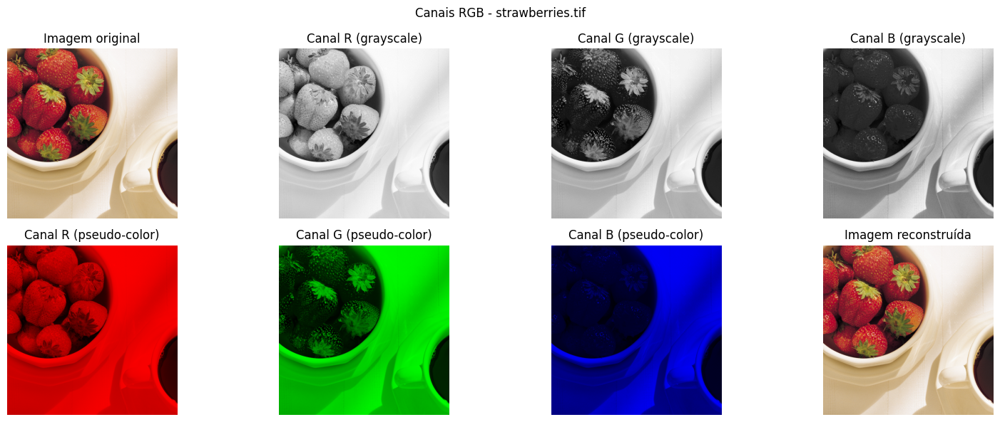

In [22]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def visualizar_canais_rgb(imagem_bgr, nome_arquivo):

    B, G, R = cv2.split(imagem_bgr)


    zeros = np.zeros_like(B)
    img_r = cv2.merge([zeros, zeros, R])
    img_g = cv2.merge([zeros, G, zeros])
    img_b = cv2.merge([B, zeros, zeros])


    img_reconstruida = cv2.merge([B, G, R])

    fig, axs = plt.subplots(2, 4, figsize=(16, 6))

    axs[0, 0].imshow(cv2.cvtColor(imagem_bgr, cv2.COLOR_BGR2RGB))
    axs[0, 0].set_title("Imagem original")

    axs[0, 1].imshow(R, cmap='gray')
    axs[0, 1].set_title("Canal R (grayscale)")

    axs[0, 2].imshow(G, cmap='gray')
    axs[0, 2].set_title("Canal G (grayscale)")

    axs[0, 3].imshow(B, cmap='gray')
    axs[0, 3].set_title("Canal B (grayscale)")

    axs[1, 0].imshow(cv2.cvtColor(img_r, cv2.COLOR_BGR2RGB))
    axs[1, 0].set_title("Canal R (pseudo-color)")

    axs[1, 1].imshow(cv2.cvtColor(img_g, cv2.COLOR_BGR2RGB))
    axs[1, 1].set_title("Canal G (pseudo-color)")

    axs[1, 2].imshow(cv2.cvtColor(img_b, cv2.COLOR_BGR2RGB))
    axs[1, 2].set_title("Canal B (pseudo-color)")

    axs[1, 3].imshow(cv2.cvtColor(img_reconstruida, cv2.COLOR_BGR2RGB))
    axs[1, 3].set_title("Imagem reconstruída")

    for ax in axs.ravel():
        ax.axis('off')

    plt.suptitle(f'Canais RGB - {nome_arquivo}')
    plt.tight_layout()
    plt.show()

for nome_arquivo, imagem_rgb in imagens.items():
    visualizar_canais_rgb(imagem_rgb, nome_arquivo)

3. Convert Between Color Spaces (RGB ↔ HSV, LAB, YCrCb, CMYK)

Objective: Convert an RGB image to other color spaces and display the result.

Topics: Color space conversion.

Challenge: Display individual channels from each converted space.


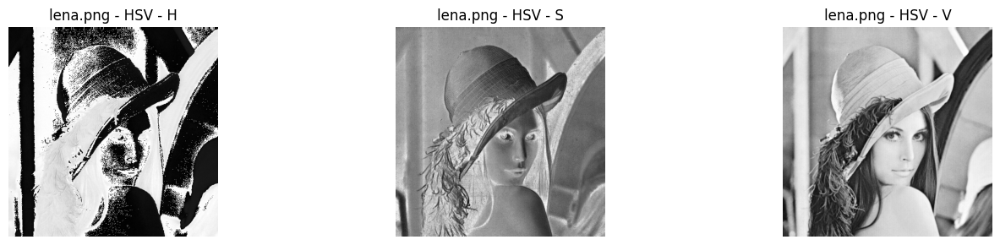

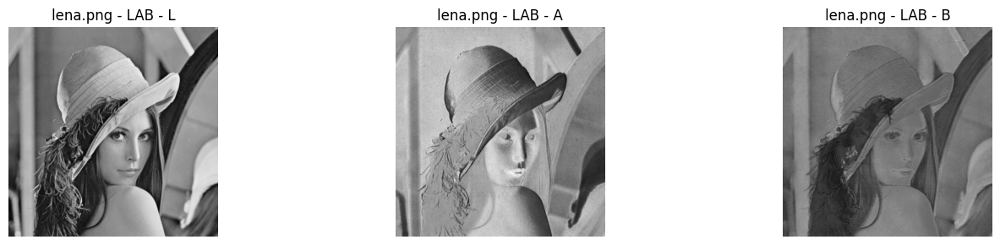

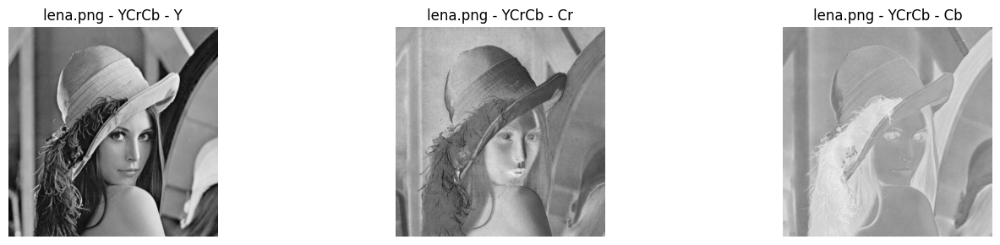

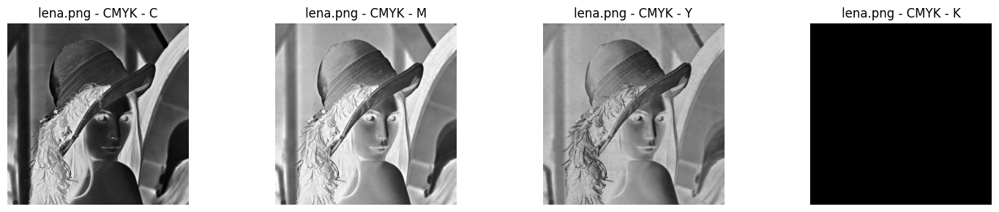

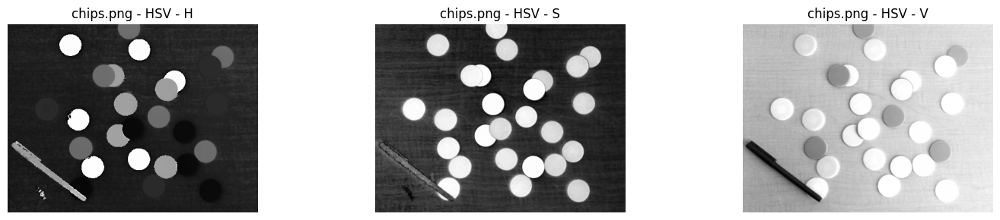

...

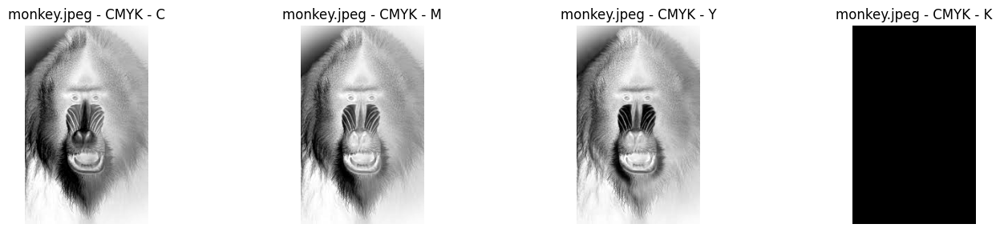

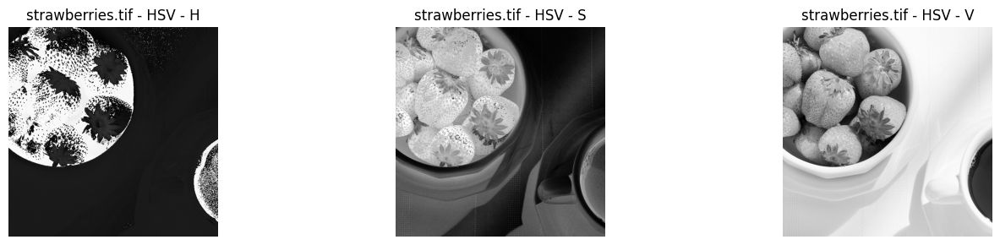

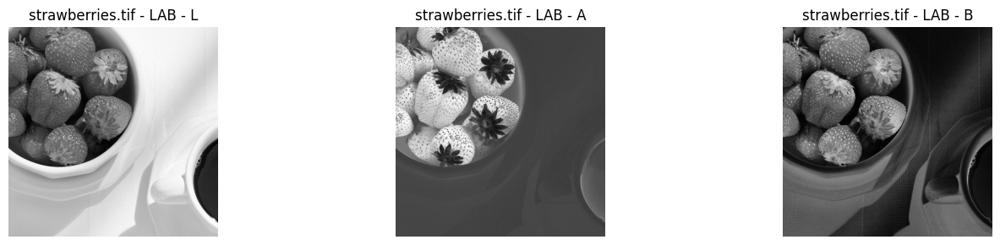

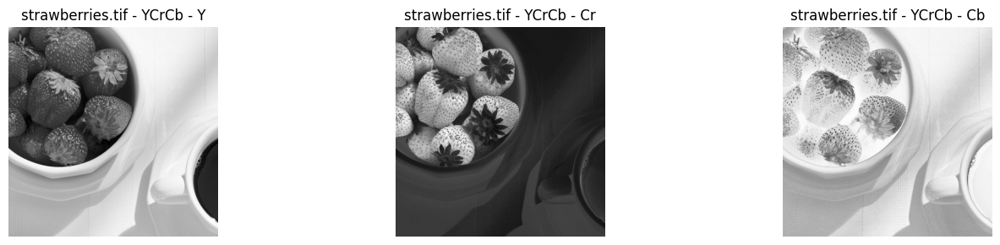

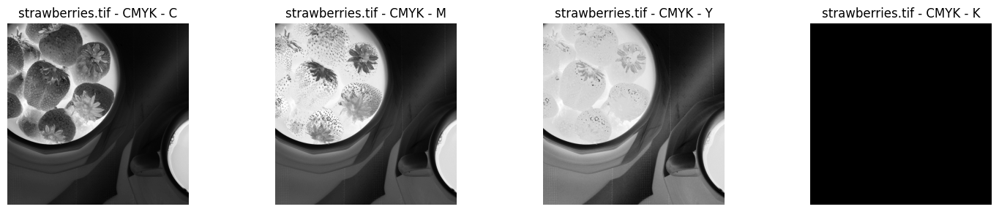

In [23]:
from PIL import Image


def mostrar_canais(canais, nomes_canais, titulo_base):
    plt.figure(figsize=(15, 3))
    for i, canal in enumerate(canais):
        plt.subplot(1, len(canais), i + 1)
        plt.imshow(canal, cmap='gray')
        plt.title(f"{titulo_base} - {nomes_canais[i]}")
        plt.axis('off')
    plt.tight_layout()
    plt.show()


def rgb_to_cmyk(imagem_rgb):
    pil_image = Image.fromarray(imagem_rgb)
    cmyk_image = pil_image.convert('CMYK')

    c, m, y, k = cmyk_image.split()
    C = np.array(c)
    M = np.array(m)
    Y = np.array(y)
    K = np.array(k)

    return C, M, Y, K


def converter_espacos_de_cor_com_cmyk(imagem_bgr, nome_arquivo):
    imagem_rgb = cv2.cvtColor(imagem_bgr, cv2.COLOR_BGR2RGB)

    # HSV
    hsv = cv2.cvtColor(imagem_bgr, cv2.COLOR_BGR2HSV)
    mostrar_canais(cv2.split(hsv), ['H', 'S', 'V'], f'{nome_arquivo} - HSV')

    # LAB
    lab = cv2.cvtColor(imagem_bgr, cv2.COLOR_BGR2LAB)
    mostrar_canais(cv2.split(lab), ['L', 'A', 'B'], f'{nome_arquivo} - LAB')

    # YCrCb
    ycrcb = cv2.cvtColor(imagem_bgr, cv2.COLOR_BGR2YCrCb)
    mostrar_canais(cv2.split(ycrcb), ['Y', 'Cr', 'Cb'], f'{nome_arquivo} - YCrCb')

    # CMYK (Usando Pillow para conversão)
    C, M, Y, K = rgb_to_cmyk(imagem_rgb)
    mostrar_canais([C, M, Y, K], ['C', 'M', 'Y', 'K'], f'{nome_arquivo} - CMYK')

for nome_arquivo, imagem_rgb in imagens.items():
    converter_espacos_de_cor_com_cmyk(imagem_rgb, nome_arquivo)



4. Compare Effects of Blurring in RGB vs HSV

Objective: Apply Gaussian blur in both RGB and HSV color spaces and compare results.

Topics: Color space effect on filtering.

Discussion: Why HSV might preserve color better in some operations.

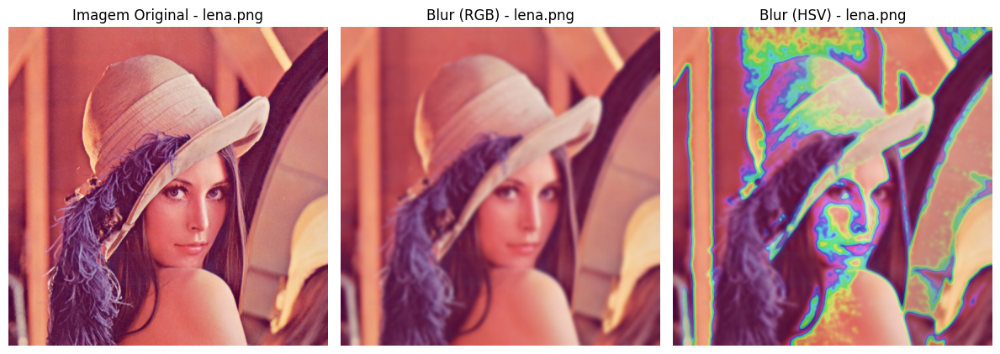

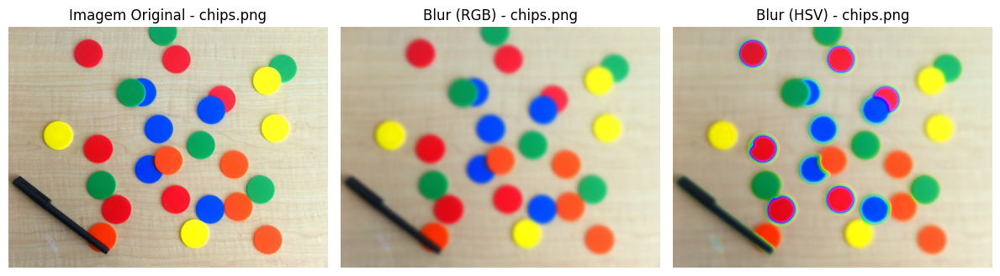

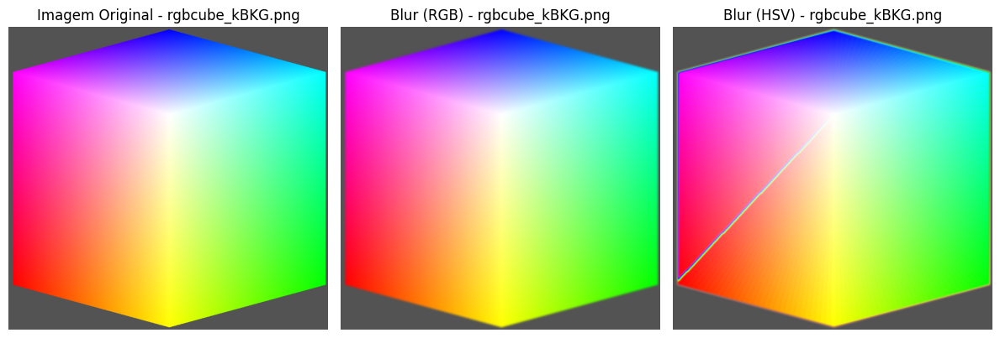

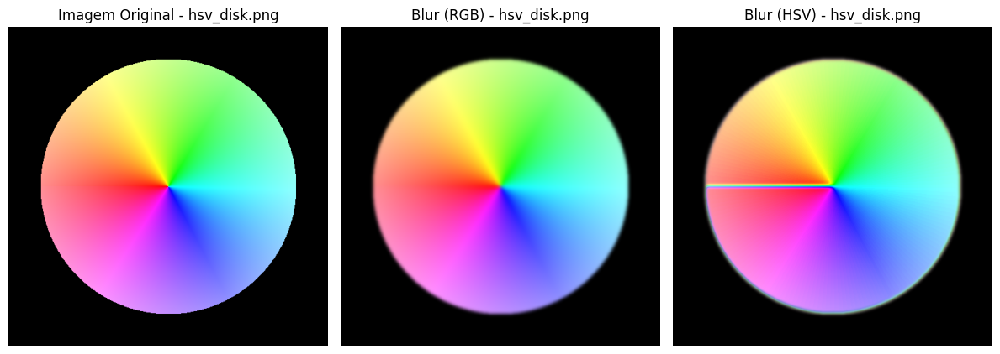

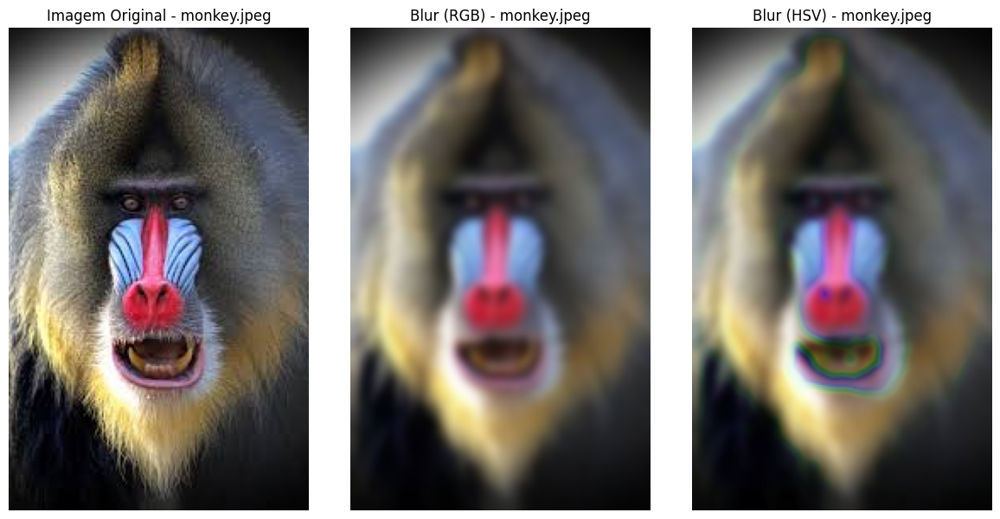

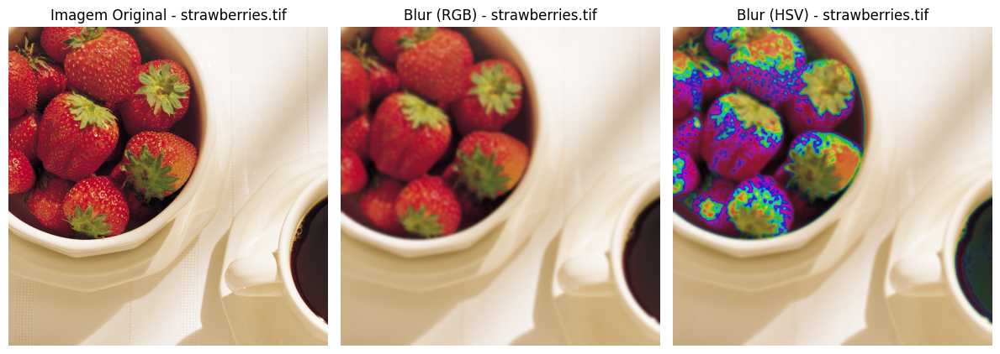

In [24]:
def aplicar_blurring(imagem_bgr, nome_arquivo):

    imagem_rgb = cv2.cvtColor(imagem_bgr, cv2.COLOR_BGR2RGB)
    imagem_rgb_blur = cv2.GaussianBlur(imagem_rgb, (15, 15), 0)


    hsv = cv2.cvtColor(imagem_bgr, cv2.COLOR_BGR2HSV)
    hsv_blur = cv2.GaussianBlur(hsv, (15, 15), 0)
    imagem_hsv_blur = cv2.cvtColor(hsv_blur, cv2.COLOR_HSV2BGR)


    plt.figure(figsize=(12, 6))


    plt.subplot(1, 3, 1)
    plt.imshow(imagem_rgb)
    plt.title(f'Imagem Original - {nome_arquivo}')
    plt.axis('off')


    plt.subplot(1, 3, 2)
    plt.imshow(imagem_rgb_blur)
    plt.title(f'Blur (RGB) - {nome_arquivo}')
    plt.axis('off')


    plt.subplot(1, 3, 3)
    plt.imshow(cv2.cvtColor(imagem_hsv_blur, cv2.COLOR_BGR2RGB))
    plt.title(f'Blur (HSV) - {nome_arquivo}')
    plt.axis('off')

    plt.tight_layout()
    plt.show()

for nome_arquivo, imagem_rgb in imagens.items():
    aplicar_blurring(imagem_rgb, nome_arquivo)



5. Apply Edge Detection Filters (Sobel, Laplacian) on Color Images

Objective: Apply Sobel and Laplacian filters on individual channels and on the grayscale version of the image.

Topics: Edge detection, spatial filtering.

Bonus: Merge edge maps from all channels to form a combined result.

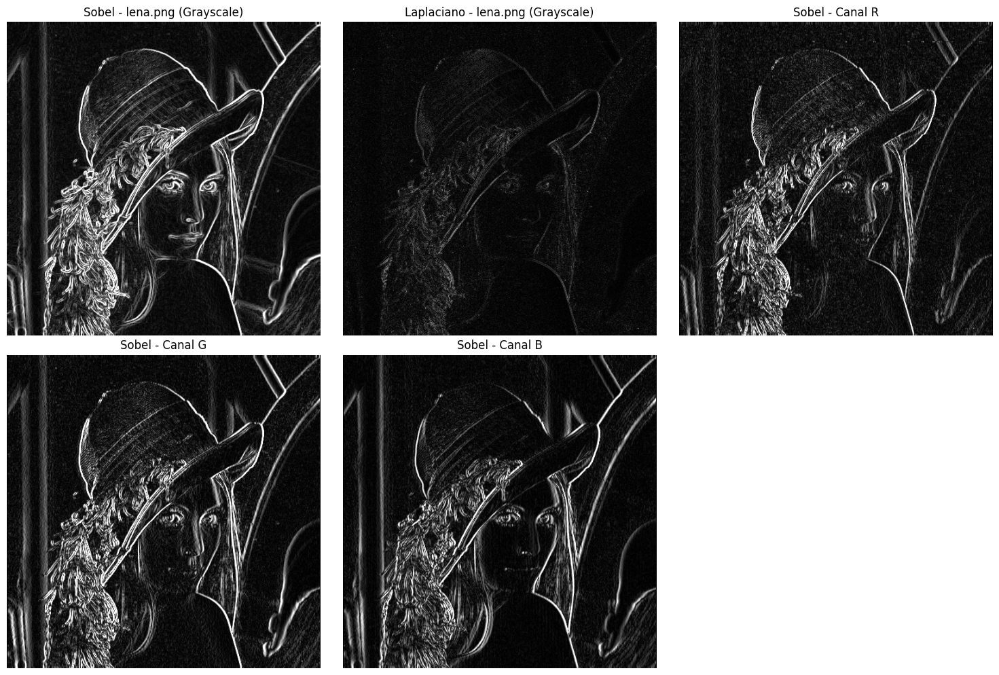

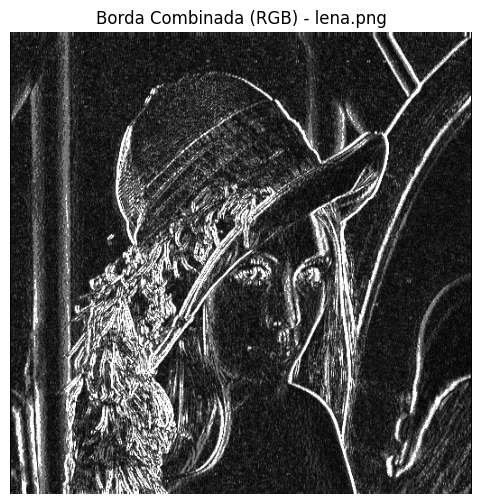

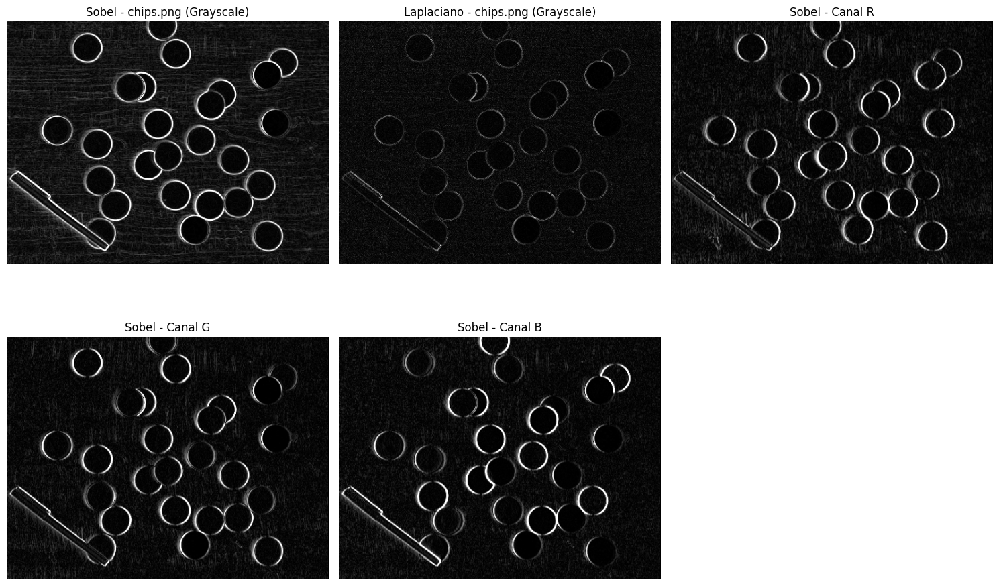

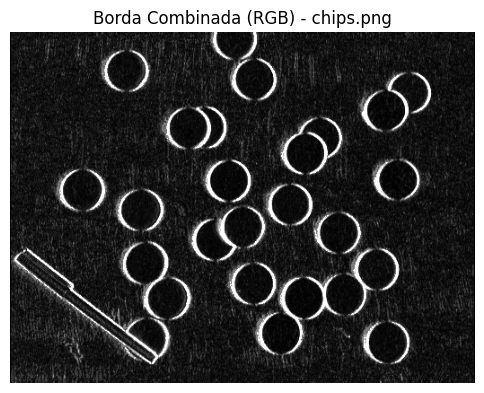

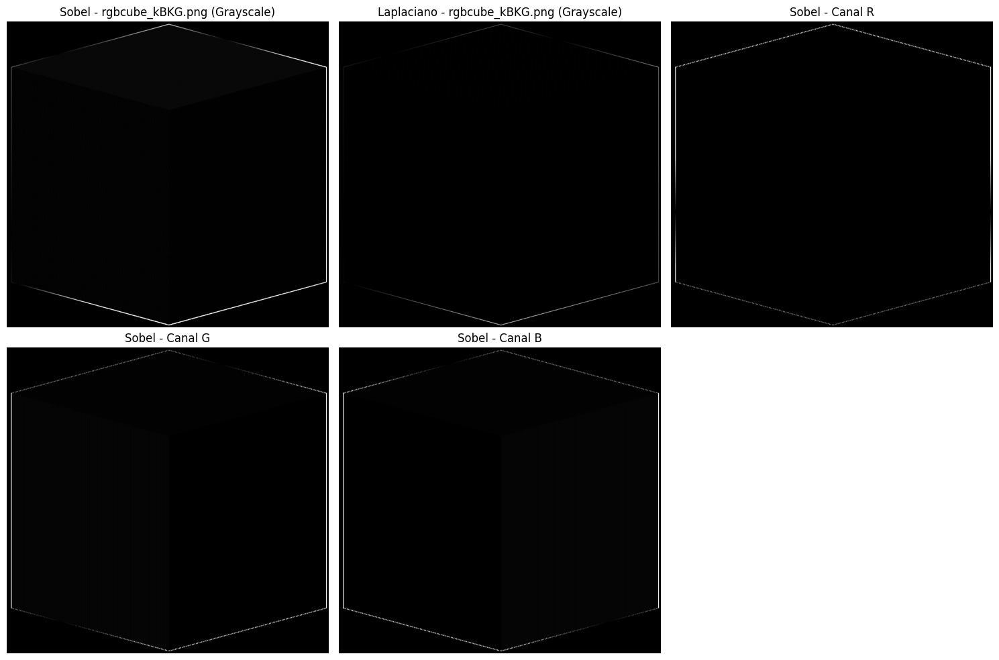

...

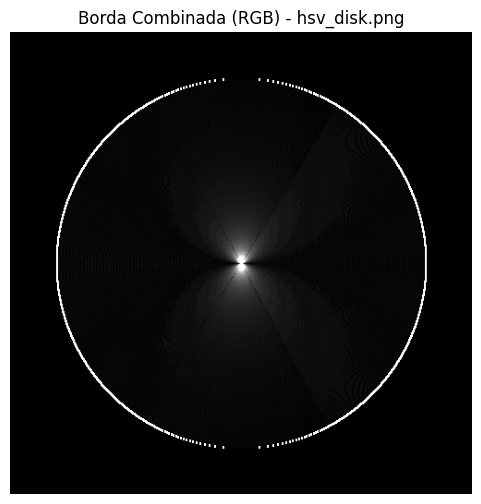

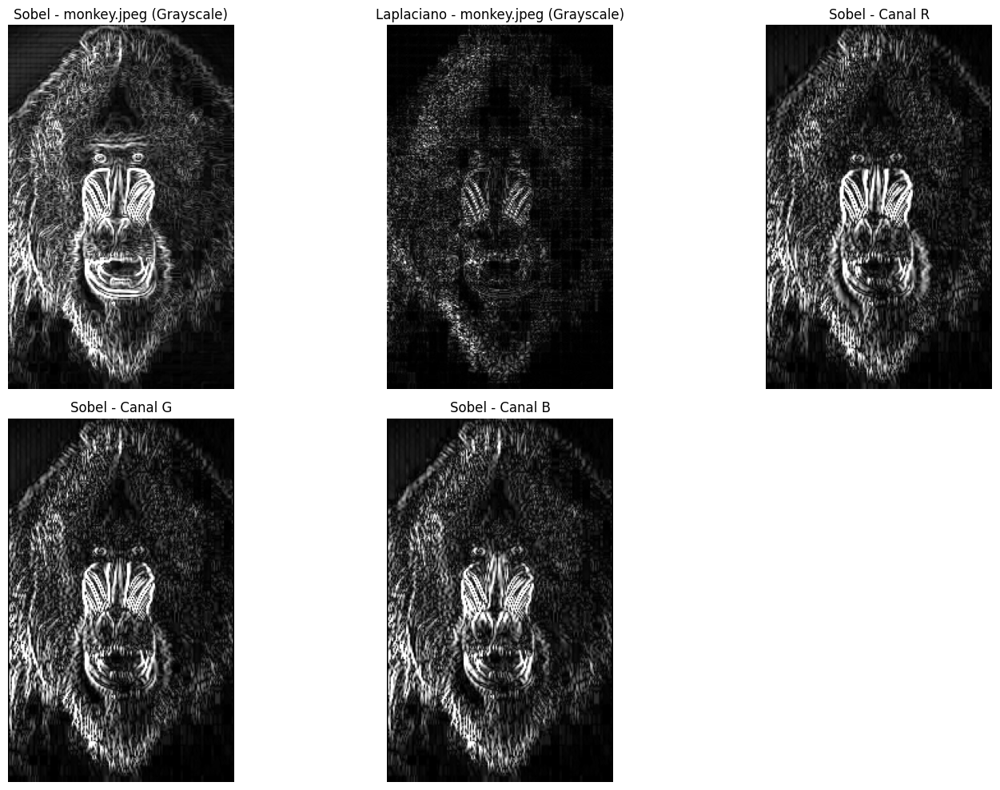

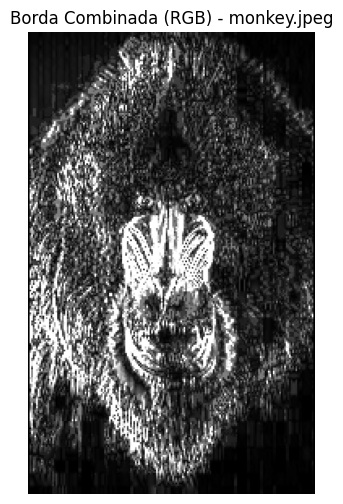

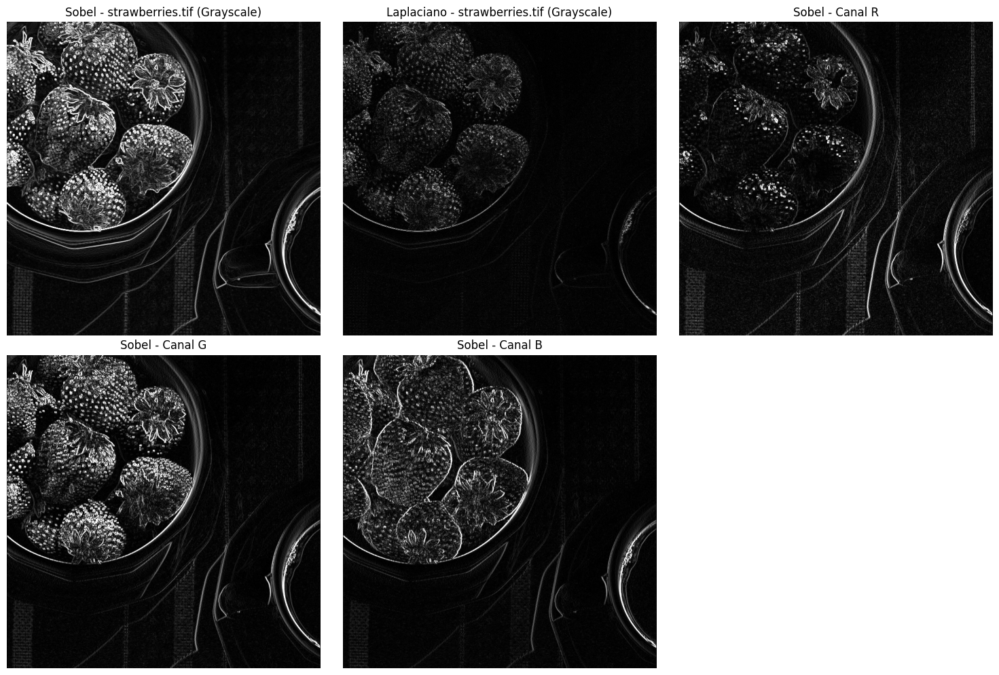

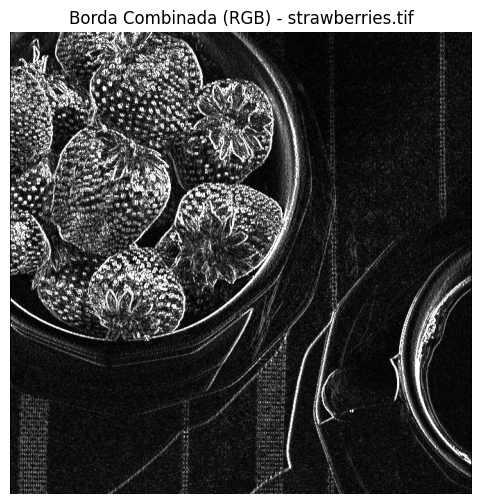

In [25]:
def aplicar_filtros_bordas(imagem_bgr, nome_arquivo):

    imagem_gray = cv2.cvtColor(imagem_bgr, cv2.COLOR_BGR2GRAY)


    sobel_x = cv2.Sobel(imagem_gray, cv2.CV_64F, 1, 0, ksize=3)
    sobel_y = cv2.Sobel(imagem_gray, cv2.CV_64F, 0, 1, ksize=3)
    sobel_combined = cv2.magnitude(sobel_x, sobel_y)


    laplaciano = cv2.Laplacian(imagem_gray, cv2.CV_64F)


    sobel_combined = cv2.convertScaleAbs(sobel_combined)
    laplaciano = cv2.convertScaleAbs(laplaciano)


    canais_rgb = cv2.split(imagem_bgr)
    sobel_rgb = [cv2.Sobel(canal, cv2.CV_64F, 1, 0, ksize=3) for canal in canais_rgb]
    sobel_rgb_combined = [cv2.convertScaleAbs(c) for c in sobel_rgb]

    laplaciano_rgb = [cv2.Laplacian(canal, cv2.CV_64F) for canal in canais_rgb]
    laplaciano_rgb_combined = [cv2.convertScaleAbs(c) for c in laplaciano_rgb]


    plt.figure(figsize=(15, 10))


    plt.subplot(2, 3, 1)
    plt.imshow(sobel_combined, cmap='gray')
    plt.title(f'Sobel - {nome_arquivo} (Grayscale)')
    plt.axis('off')


    plt.subplot(2, 3, 2)
    plt.imshow(laplaciano, cmap='gray')
    plt.title(f'Laplaciano - {nome_arquivo} (Grayscale)')
    plt.axis('off')


    for i, canal_sobel in enumerate(sobel_rgb_combined):
        plt.subplot(2, 3, 3 + i)
        plt.imshow(canal_sobel, cmap='gray')
        plt.title(f'Sobel - Canal {["R", "G", "B"][i]}')
        plt.axis('off')

    plt.tight_layout()
    plt.show()


    borda_combinada_rgb = cv2.bitwise_or(sobel_rgb_combined[0], sobel_rgb_combined[1])
    borda_combinada_rgb = cv2.bitwise_or(borda_combinada_rgb, sobel_rgb_combined[2])

    plt.figure(figsize=(6, 6))
    plt.imshow(borda_combinada_rgb, cmap='gray')
    plt.title(f'Borda Combinada (RGB) - {nome_arquivo}')
    plt.axis('off')
    plt.show()

for nome_arquivo, imagem_rgb in imagens.items():
     aplicar_filtros_bordas(imagem_rgb, nome_arquivo)


6. High-pass and Low-pass Filtering in the Frequency Domain

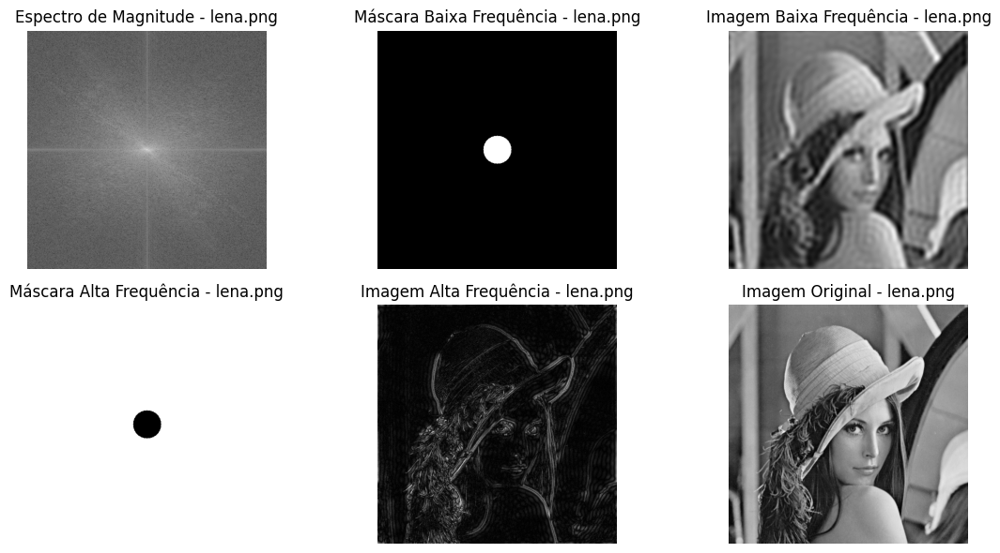

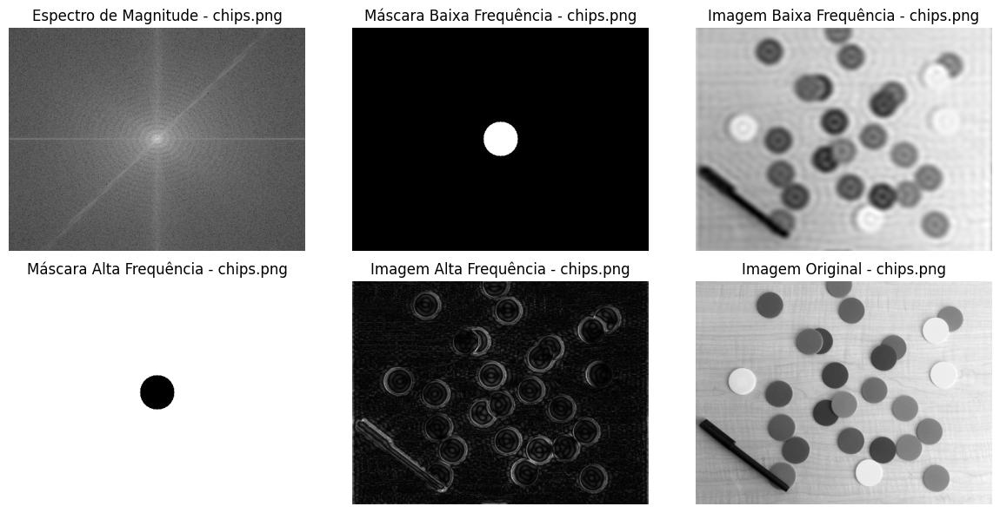

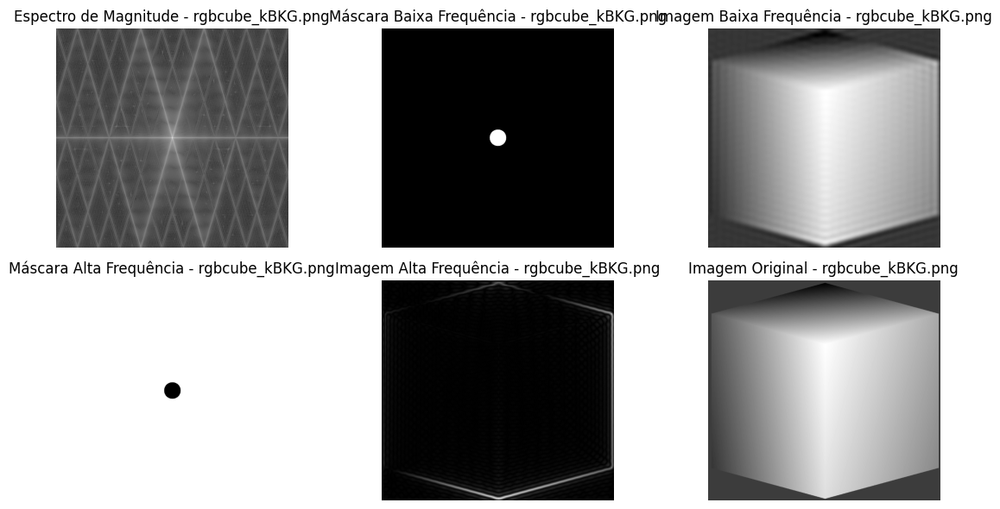

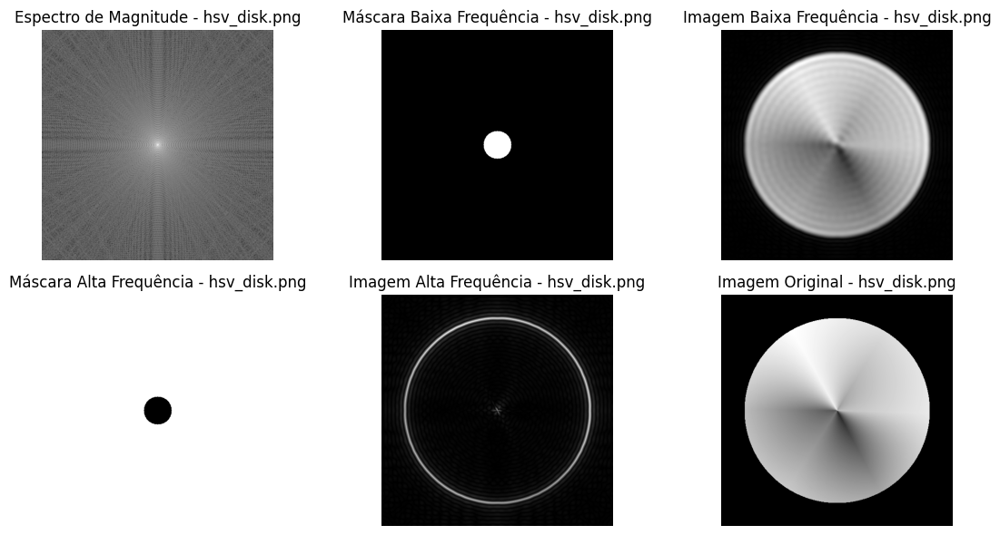

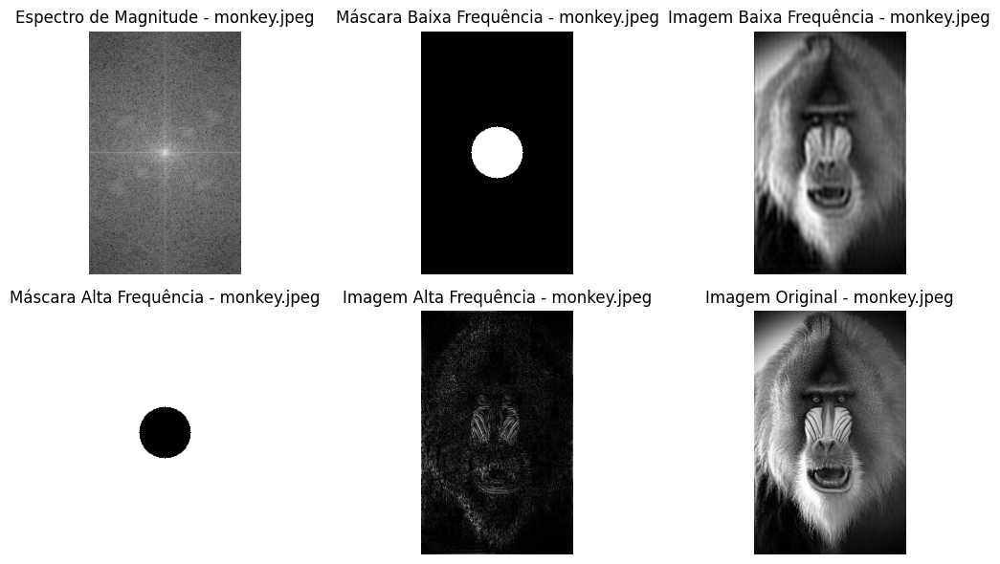

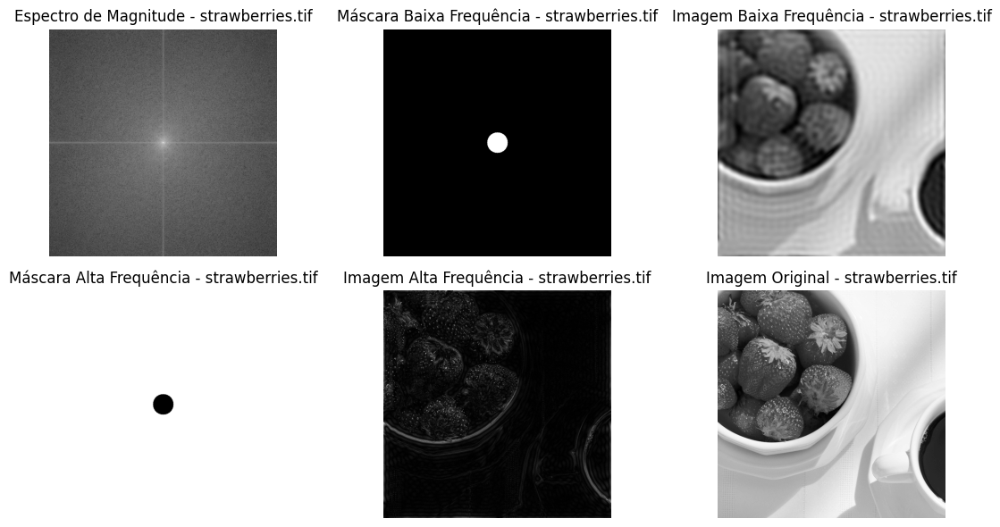

In [26]:
def aplicar_filtros_frequencia(imagem_bgr, nome_arquivo):

    imagem_gray = cv2.cvtColor(imagem_bgr, cv2.COLOR_BGR2GRAY)


    dft = cv2.dft(np.float32(imagem_gray), flags=cv2.DFT_COMPLEX_OUTPUT)
    dft_shift = np.fft.fftshift(dft)


    magnitude = cv2.magnitude(dft_shift[:, :, 0], dft_shift[:, :, 1])
    magnitude = np.log(magnitude + 1)


    rows, cols = imagem_gray.shape
    crow, ccol = rows // 2, cols // 2
    mask_low = np.zeros((rows, cols), np.uint8)
    r = 30
    center = [crow, ccol]
    cv2.circle(mask_low, (center[1], center[0]), r, 1, -1)

    mask_high = np.ones((rows, cols), np.uint8)
    cv2.circle(mask_high, (center[1], center[0]), r, 0, -1)


    dft_shift_low = dft_shift * mask_low[:, :, np.newaxis]
    dft_shift_high = dft_shift * mask_high[:, :, np.newaxis]


    img_back_low = cv2.idft(np.fft.ifftshift(dft_shift_low))
    img_back_high = cv2.idft(np.fft.ifftshift(dft_shift_high))

    img_back_low = cv2.magnitude(img_back_low[:, :, 0], img_back_low[:, :, 1])
    img_back_high = cv2.magnitude(img_back_high[:, :, 0], img_back_high[:, :, 1])


    plt.figure(figsize=(12, 6))


    plt.subplot(2, 3, 1)
    plt.imshow(magnitude, cmap='gray')
    plt.title(f'Espectro de Magnitude - {nome_arquivo}')
    plt.axis('off')


    plt.subplot(2, 3, 2)
    plt.imshow(mask_low, cmap='gray')
    plt.title(f'Máscara Baixa Frequência - {nome_arquivo}')
    plt.axis('off')


    plt.subplot(2, 3, 3)
    plt.imshow(img_back_low, cmap='gray')
    plt.title(f'Imagem Baixa Frequência - {nome_arquivo}')
    plt.axis('off')


    plt.subplot(2, 3, 4)
    plt.imshow(mask_high, cmap='gray')
    plt.title(f'Máscara Alta Frequência - {nome_arquivo}')
    plt.axis('off')


    plt.subplot(2, 3, 5)
    plt.imshow(img_back_high, cmap='gray')
    plt.title(f'Imagem Alta Frequência - {nome_arquivo}')
    plt.axis('off')


    plt.subplot(2, 3, 6)
    plt.imshow(imagem_gray, cmap='gray')
    plt.title(f'Imagem Original - {nome_arquivo}')
    plt.axis('off')

    plt.tight_layout()
    plt.show()


for nome_arquivo, imagem_rgb in imagens.items():
        aplicar_filtros_frequencia(imagem_rgb, nome_arquivo)



7. Visualize and Manipulate Bit Planes of Color Images

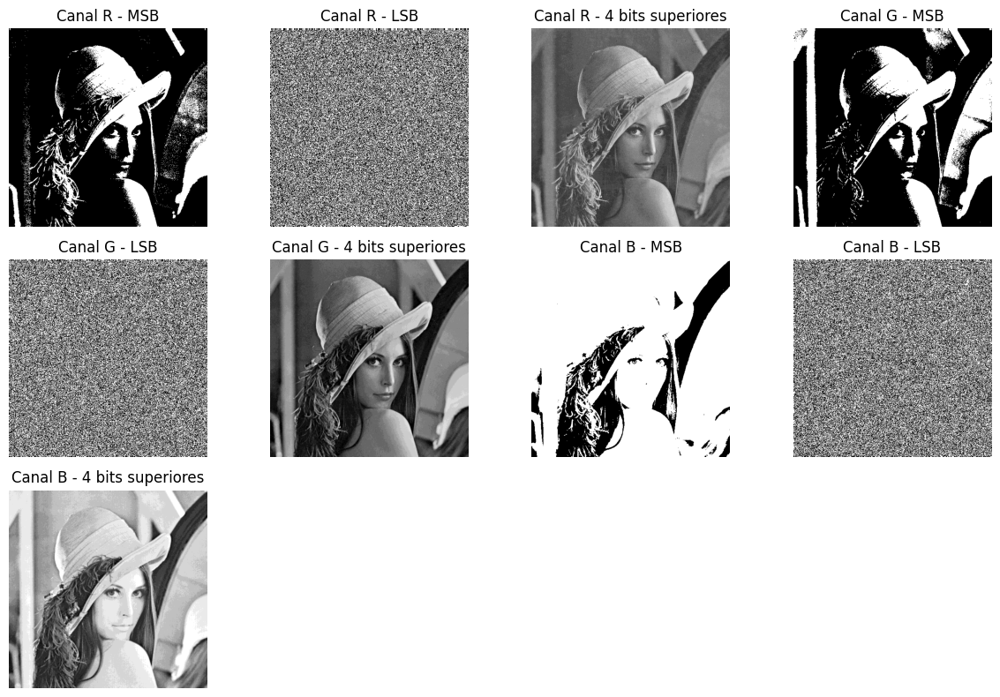

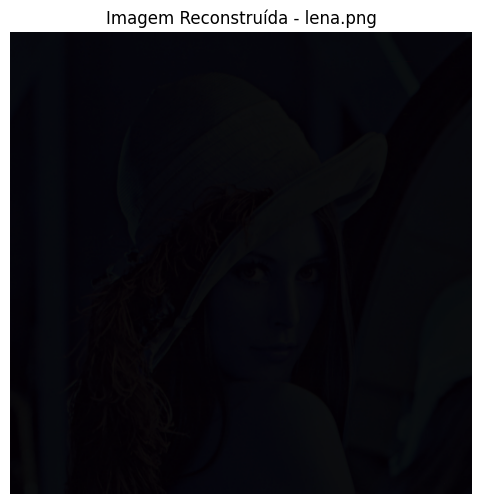

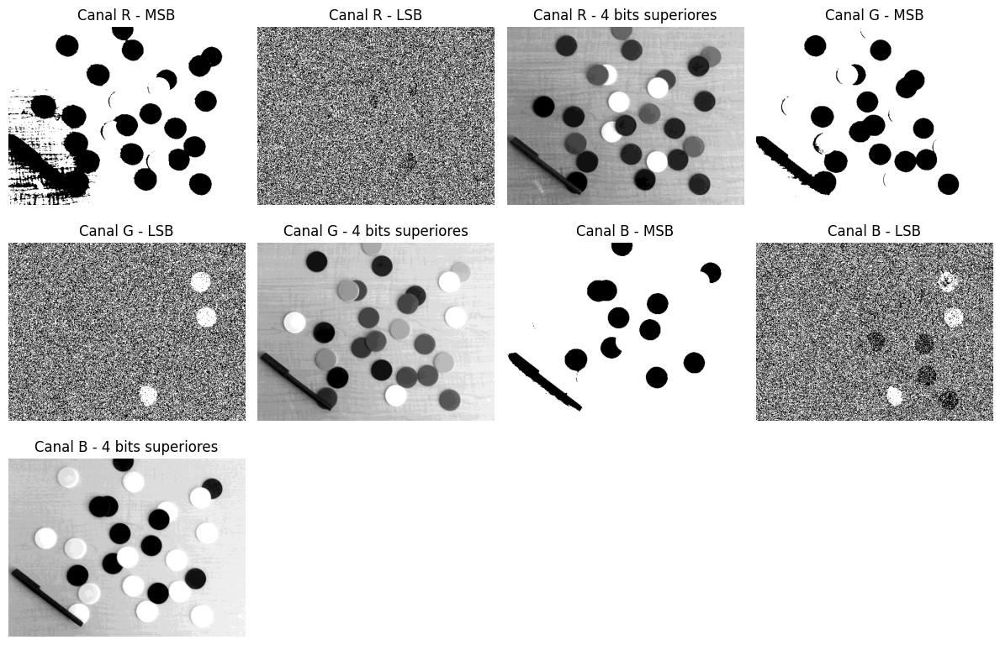

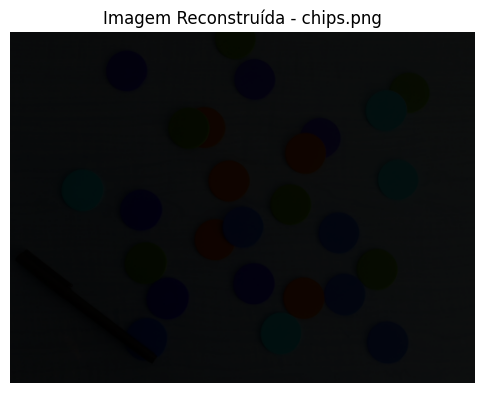

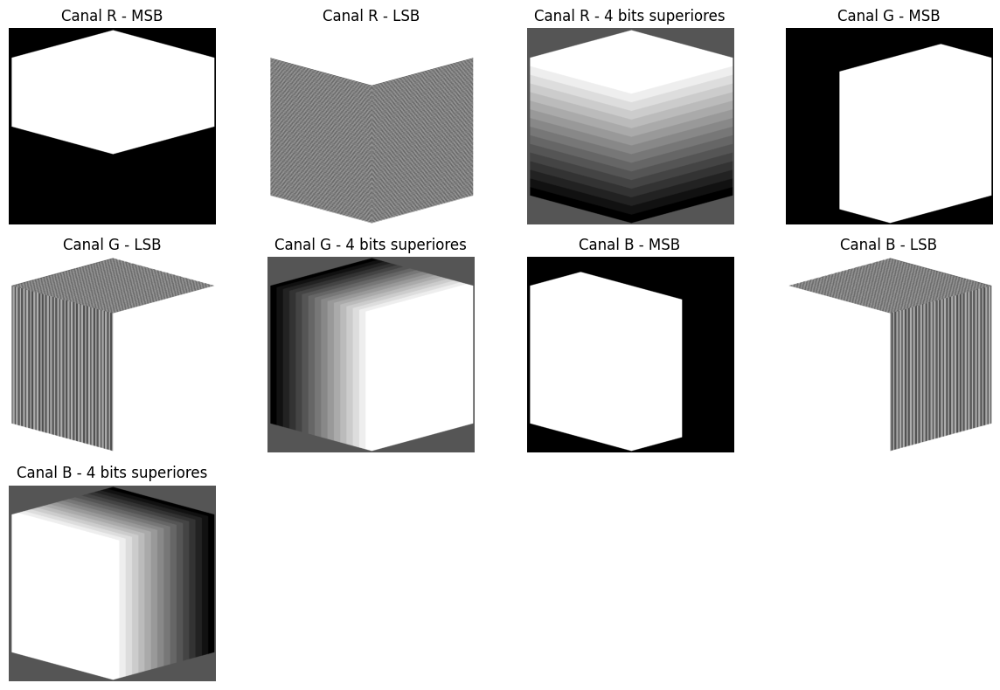

...

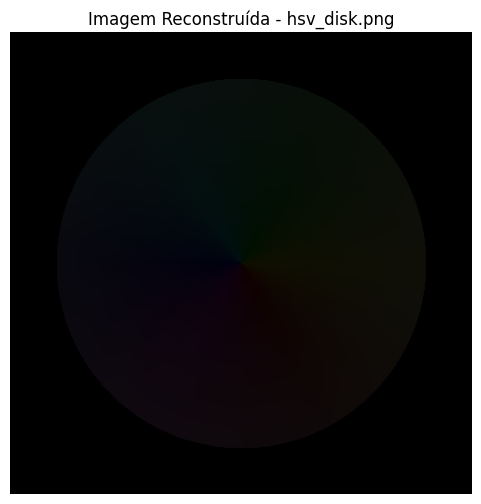

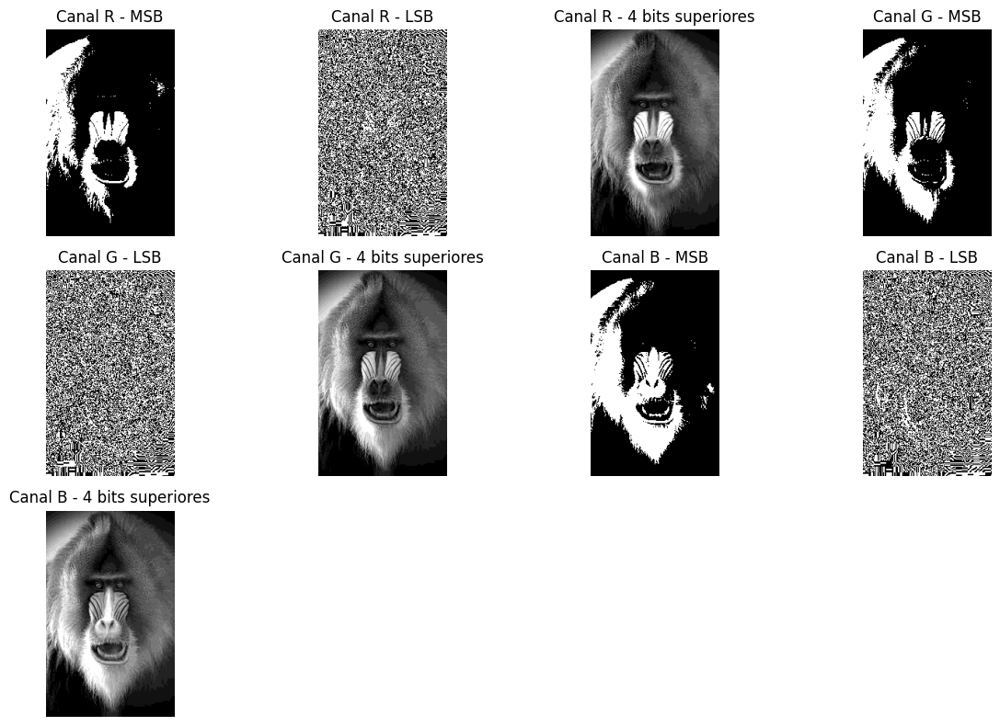

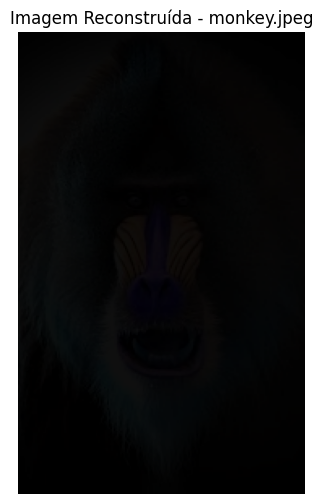

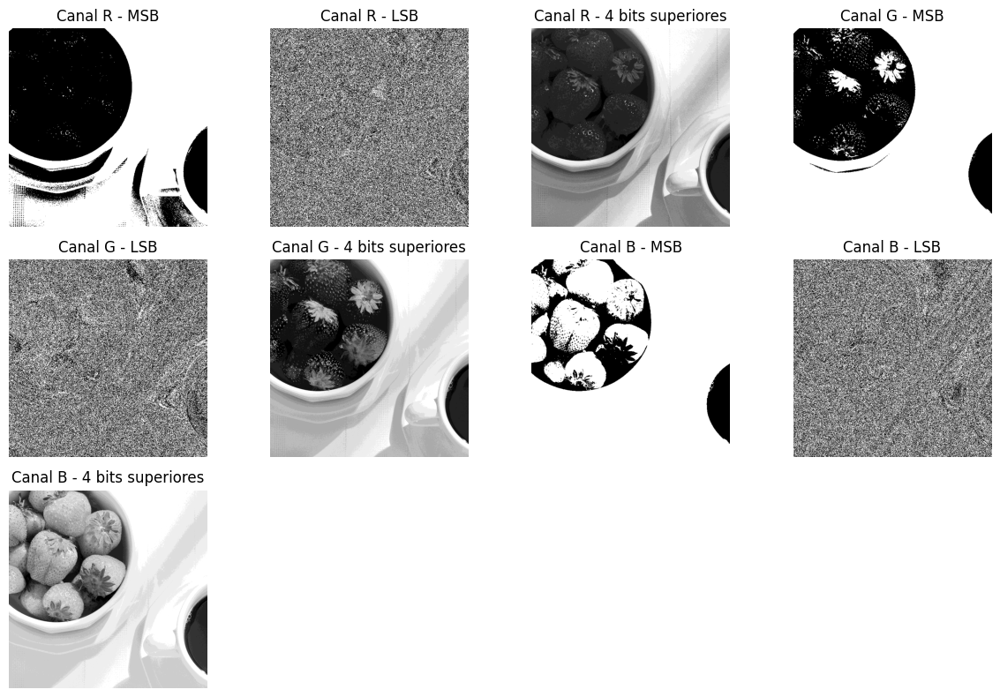

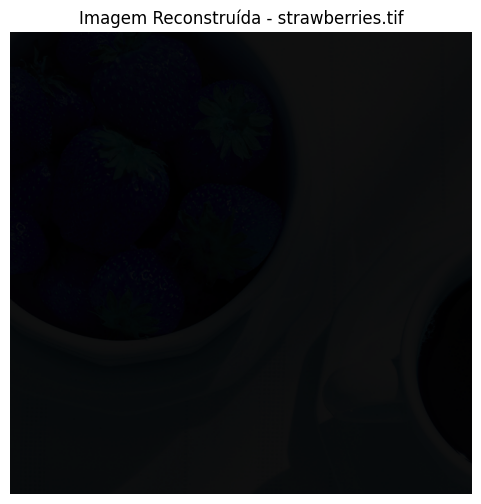

In [27]:
def extrair_planos_de_bits(imagem_bgr, nome_arquivo):

    canais_rgb = cv2.split(imagem_bgr)

    planos_de_bits = {}
    for i, canal in enumerate(canais_rgb):

        MSB = canal >> 7
        LSB = canal & 1


        planos_de_bits[f'Canal {["R", "G", "B"][i]} - MSB'] = MSB
        planos_de_bits[f'Canal {["R", "G", "B"][i]} - LSB'] = LSB


        canal_4bits = (canal >> 4) & 15
        planos_de_bits[f'Canal {["R", "G", "B"][i]} - 4 bits superiores'] = canal_4bits


    plt.figure(figsize=(12, 8))

    for i, (nome, plano) in enumerate(planos_de_bits.items()):
        plt.subplot(3, 4, i + 1)
        plt.imshow(plano, cmap='gray')
        plt.title(nome)
        plt.axis('off')

    plt.tight_layout()
    plt.show()


    reconstruido = cv2.merge([planos_de_bits[f'Canal {["R", "G", "B"][i]} - 4 bits superiores'] for i in range(3)])
    plt.figure(figsize=(6, 6))
    plt.imshow(reconstruido)
    plt.title(f'Imagem Reconstruída - {nome_arquivo}')
    plt.axis('off')
    plt.show()

for nome_arquivo, imagem_rgb in imagens.items():
        extrair_planos_de_bits(imagem_rgb, nome_arquivo)


8. Color-based Object Segmentation using HSV Thresholding

In [28]:


def segmentar_objetos_com_base_em_cor(imagem_bgr, nome_arquivo):
    imagem_hsv = cv2.cvtColor(imagem_bgr, cv2.COLOR_BGR2HSV)
    imagem_exibicao = cv2.cvtColor(imagem_bgr, cv2.COLOR_BGR2RGB)
    init_h_min, init_h_max = 0, 179
    init_s_min, init_s_max = 100, 255
    init_v_min, init_v_max = 100, 255

    h_min = widgets.IntSlider(value=0, min=0, max=179, description='H Min:')
    h_max = widgets.IntSlider(value=179, min=0, max=179, description='H Max:')
    s_min = widgets.IntSlider(value=100, min=0, max=255, description='S Min:')
    s_max = widgets.IntSlider(value=255, min=0, max=255, description='S Max:')
    v_min = widgets.IntSlider(value=100, min=0, max=255, description='V Min:')
    v_max = widgets.IntSlider(value=255, min=0, max=255, description='V Max:')

    out = widgets.Output()
    
    def atualizar_segmentacao(h_min, h_max, s_min, s_max, v_min, v_max):
        with out:
            out.clear_output(wait=True)
            limite_inferior = np.array([h_min, s_min, v_min])
            limite_superior = np.array([h_max, s_max, v_max])
            mascara = cv2.inRange(imagem_hsv, limite_inferior, limite_superior)
            resultado_segmentado = cv2.bitwise_and(imagem_bgr, imagem_bgr, mask=mascara)
            resultado_segmentado_rgb = cv2.cvtColor(resultado_segmentado, cv2.COLOR_BGR2RGB)
            
            plt.figure(figsize=(15, 5))
            plt.subplot(1, 3, 1)
            plt.imshow(imagem_exibicao)
            plt.title('Imagem Original')
            plt.axis('off')
            plt.subplot(1, 3, 2)
            plt.imshow(mascara, cmap='gray')
            plt.title('Máscara HSV')
            plt.axis('off')
            plt.subplot(1, 3, 3)
            plt.imshow(resultado_segmentado_rgb)
            plt.title('Objetos Segmentados')
            plt.axis('off')
            plt.tight_layout()
            plt.show()
            plt.clf()  # Limpar a figura após cada exibição

    widgets.interactive(atualizar_segmentacao, 
                       h_min=h_min, h_max=h_max,
                       s_min=s_min, s_max=s_max,
                       v_min=v_min, v_max=v_max)
    
    display(h_min, h_max, s_min, s_max, v_min, v_max, out)
    
    atualizar_segmentacao(init_h_min, init_h_max, 
                         init_s_min, init_s_max, 
                         init_v_min, init_v_max)

for nome_arquivo, imagem_rgb in imagens.items():
    segmentar_objetos_com_base_em_cor(imagem_rgb, nome_arquivo)


IntSlider(value=0, description='H Min:', max=179)

IntSlider(value=179, description='H Max:', max=179)

IntSlider(value=100, description='S Min:', max=255)

IntSlider(value=255, description='S Max:', max=255)

IntSlider(value=100, description='V Min:', max=255)

IntSlider(value=255, description='V Max:', max=255)

Output()

<Figure size 640x480 with 0 Axes>

IntSlider(value=0, description='H Min:', max=179)

IntSlider(value=179, description='H Max:', max=179)

IntSlider(value=100, description='S Min:', max=255)

IntSlider(value=255, description='S Max:', max=255)

IntSlider(value=100, description='V Min:', max=255)

IntSlider(value=255, description='V Max:', max=255)

Output()

<Figure size 640x480 with 0 Axes>

IntSlider(value=0, description='H Min:', max=179)

IntSlider(value=179, description='H Max:', max=179)

IntSlider(value=100, description='S Min:', max=255)

IntSlider(value=255, description='S Max:', max=255)

IntSlider(value=100, description='V Min:', max=255)

IntSlider(value=255, description='V Max:', max=255)

Output()

<Figure size 640x480 with 0 Axes>

IntSlider(value=0, description='H Min:', max=179)

IntSlider(value=179, description='H Max:', max=179)

IntSlider(value=100, description='S Min:', max=255)

IntSlider(value=255, description='S Max:', max=255)

IntSlider(value=100, description='V Min:', max=255)

IntSlider(value=255, description='V Max:', max=255)

Output()

<Figure size 640x480 with 0 Axes>

IntSlider(value=0, description='H Min:', max=179)

IntSlider(value=179, description='H Max:', max=179)

IntSlider(value=100, description='S Min:', max=255)

IntSlider(value=255, description='S Max:', max=255)

IntSlider(value=100, description='V Min:', max=255)

IntSlider(value=255, description='V Max:', max=255)

Output()

<Figure size 640x480 with 0 Axes>

IntSlider(value=0, description='H Min:', max=179)

IntSlider(value=179, description='H Max:', max=179)

IntSlider(value=100, description='S Min:', max=255)

IntSlider(value=255, description='S Max:', max=255)

IntSlider(value=100, description='V Min:', max=255)

IntSlider(value=255, description='V Max:', max=255)

Output()

<Figure size 640x480 with 0 Axes>

9. Convert and Visualize Images in the NTSC (YIQ) Color Space

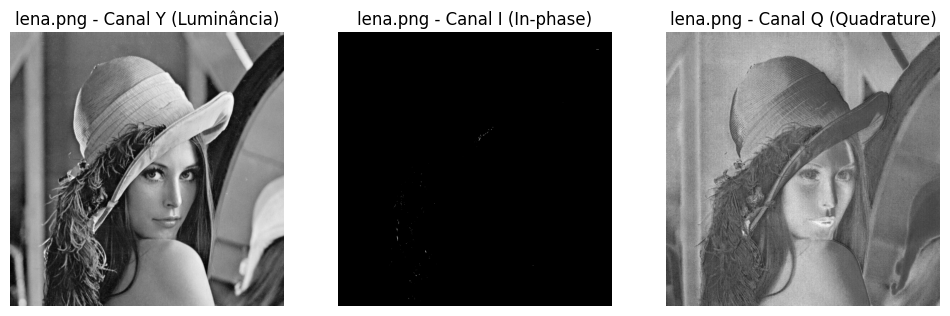

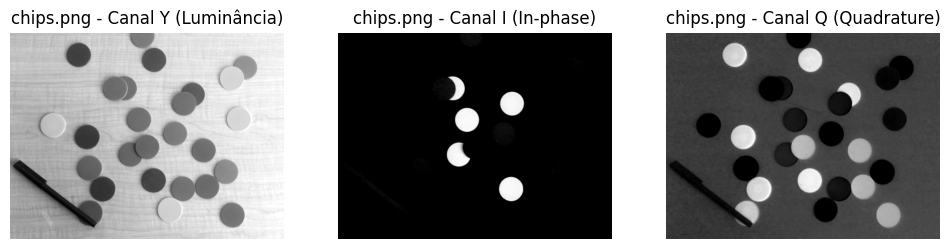

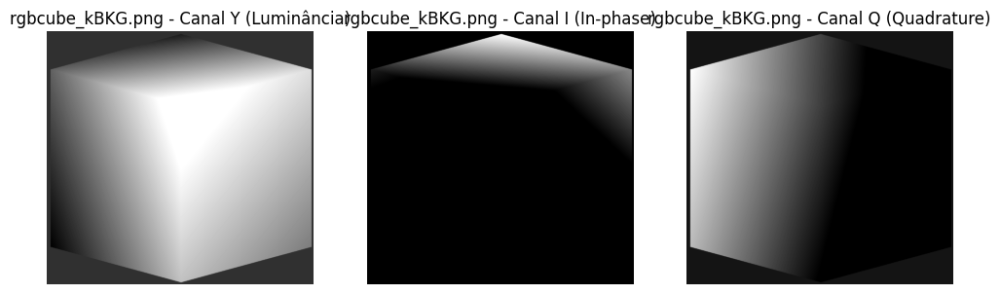

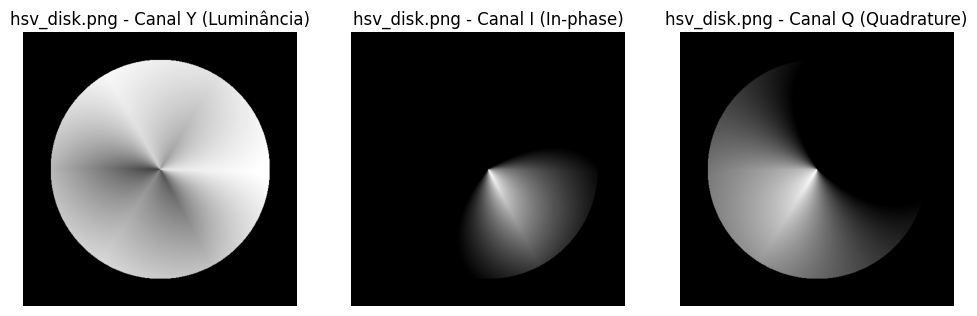

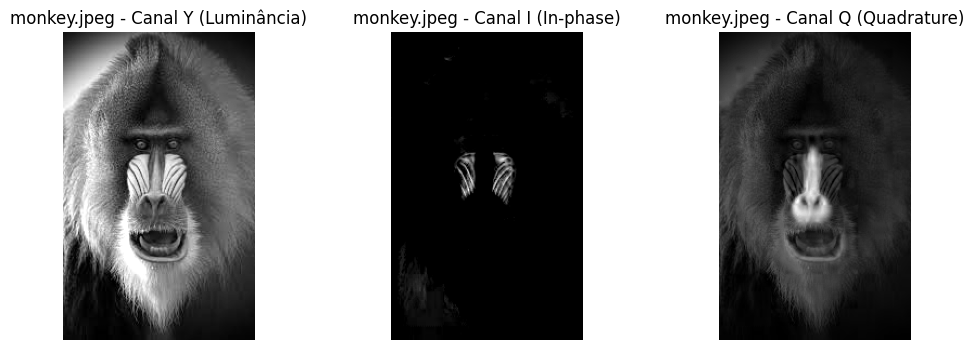

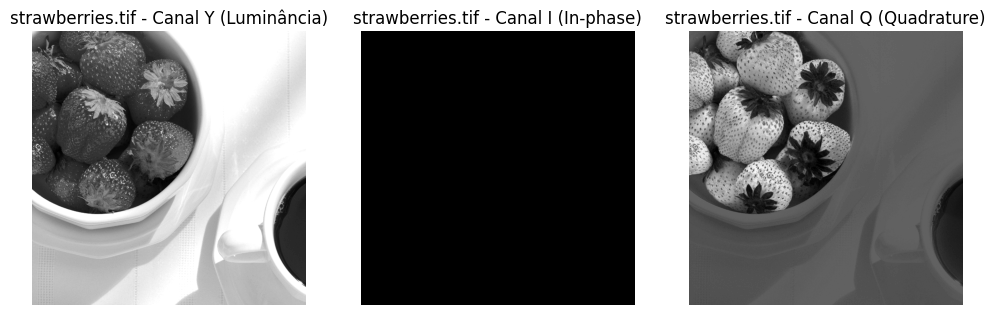

In [29]:

def rgb_para_ntsc(imagem_rgb):

    imagem_rgb = imagem_rgb / 255.0


    matriz_rgb_para_ntsc = np.array([[0.299, 0.587, 0.114],
                                     [0.596, -0.274, -0.322],
                                     [0.211, -0.523, 0.312]])

    imagem_ntsc = cv2.transform(imagem_rgb, matriz_rgb_para_ntsc.T)


    imagem_ntsc = np.clip(imagem_ntsc, 0, 1)

    Y, I, Q = cv2.split(imagem_ntsc)

    return Y, I, Q


def exibir_canais_ntsc(imagem_rgb, nome_arquivo):

    Y, I, Q = rgb_para_ntsc(imagem_rgb)


    plt.figure(figsize=(12, 4))


    plt.subplot(1, 3, 1)
    plt.imshow(Y, cmap='gray')
    plt.title(f'{nome_arquivo} - Canal Y (Luminância)')
    plt.axis('off')


    plt.subplot(1, 3, 2)
    plt.imshow(I, cmap='gray')
    plt.title(f'{nome_arquivo} - Canal I (In-phase)')
    plt.axis('off')

    plt.subplot(1, 3, 3)
    plt.imshow(Q, cmap='gray')
    plt.title(f'{nome_arquivo} - Canal Q (Quadrature)')
    plt.axis('off')

    plt.show()


for nome_arquivo, imagem_rgb in imagens.items():
    exibir_canais_ntsc(imagem_rgb, nome_arquivo)


10. Color Image Enhancement with Histogram Equalization

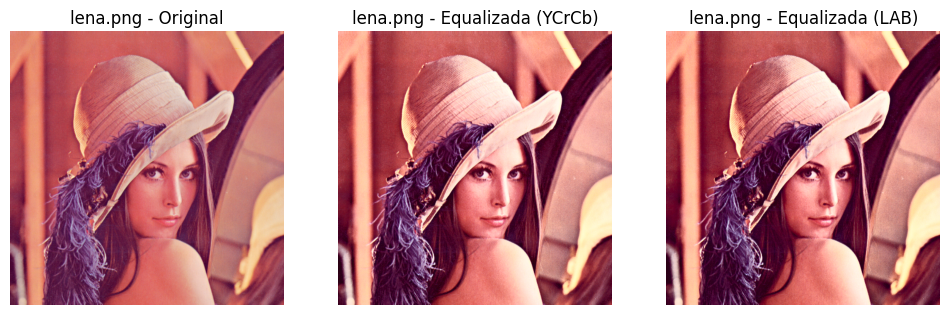

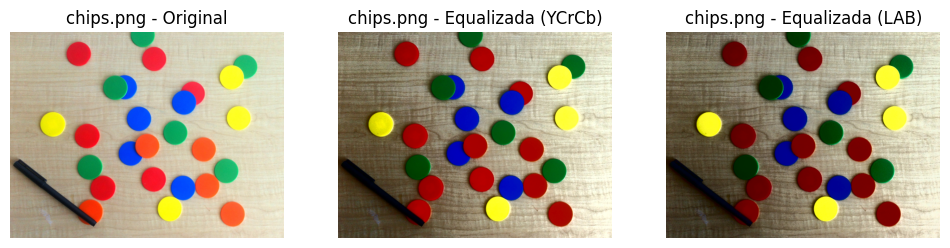

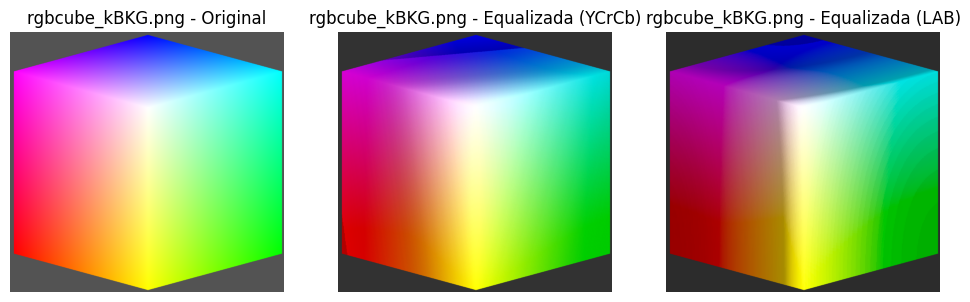

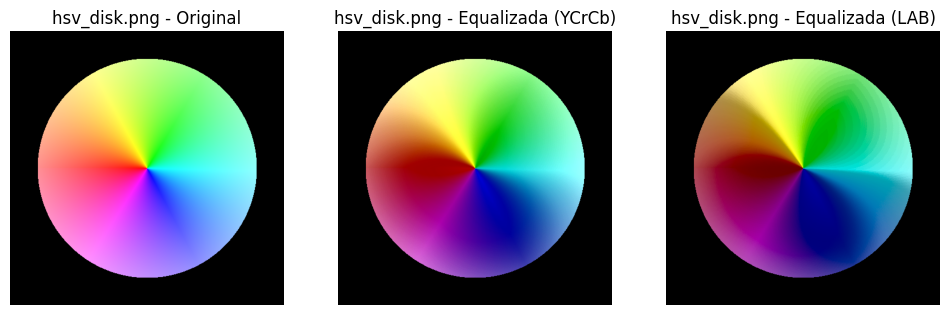

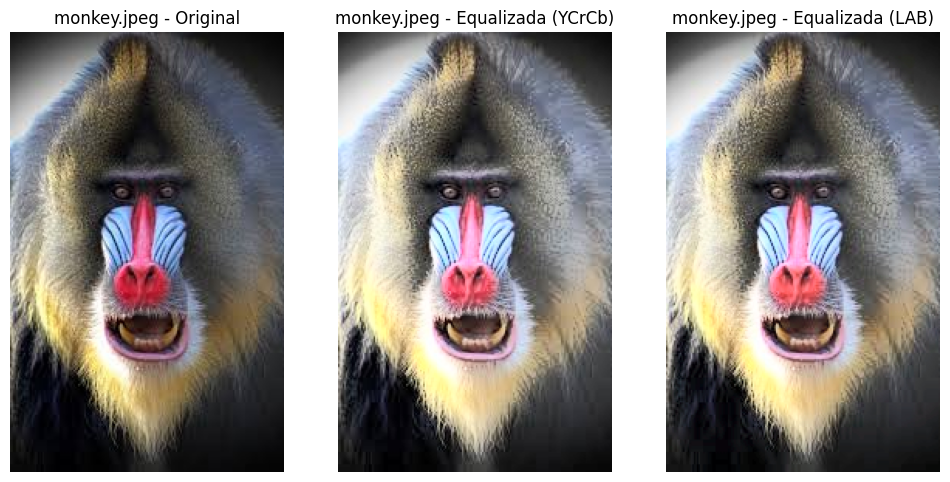

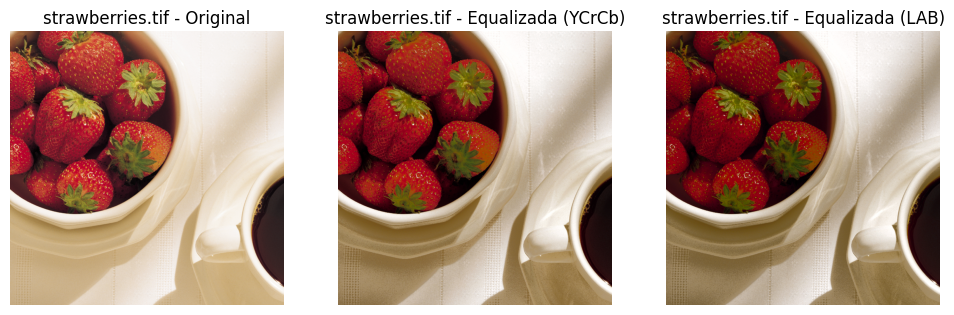

In [30]:

def equalizar_histograma(imagem_bgr, nome_arquivo):

    imagem_ycrcb = cv2.cvtColor(imagem_bgr, cv2.COLOR_BGR2YCrCb)


    canais_ycrcb = list(cv2.split(imagem_ycrcb))


    canais_ycrcb[0] = cv2.equalizeHist(canais_ycrcb[0])


    imagem_ycrcb_equalizada = cv2.merge(canais_ycrcb)


    imagem_ycrcb_equalizada_bgr = cv2.cvtColor(imagem_ycrcb_equalizada, cv2.COLOR_YCrCb2BGR)


    imagem_lab = cv2.cvtColor(imagem_bgr, cv2.COLOR_BGR2LAB)


    canais_lab = list(cv2.split(imagem_lab))


    canais_lab[0] = cv2.equalizeHist(canais_lab[0])


    imagem_lab_equalizada = cv2.merge(canais_lab)

    imagem_lab_equalizada_bgr = cv2.cvtColor(imagem_lab_equalizada, cv2.COLOR_LAB2BGR)


    plt.figure(figsize=(12, 6))


    plt.subplot(1, 3, 1)
    plt.imshow(cv2.cvtColor(imagem_bgr, cv2.COLOR_BGR2RGB))
    plt.title(f'{nome_arquivo} - Original')
    plt.axis('off')

    plt.subplot(1, 3, 2)
    plt.imshow(cv2.cvtColor(imagem_ycrcb_equalizada_bgr, cv2.COLOR_BGR2RGB))
    plt.title(f'{nome_arquivo} - Equalizada (YCrCb)')
    plt.axis('off')


    plt.subplot(1, 3, 3)
    plt.imshow(cv2.cvtColor(imagem_lab_equalizada_bgr, cv2.COLOR_BGR2RGB))
    plt.title(f'{nome_arquivo} - Equalizada (LAB)')
    plt.axis('off')

    plt.show()


for nome_arquivo, imagem_rgb in imagens.items():
        equalizar_histograma(imagem_rgb, nome_arquivo)
